### Local Setup

In [2]:
from pathlib import Path
import sys

# Make this path be the project's "base" directory, so we can include modules
notebook_directory_ancestor = Path.cwd().resolve().parent.parent.parent.parent
print(notebook_directory_ancestor)
core_code_directory = notebook_directory_ancestor / "PythonLibraries" / "CoreCode"

is_core_code_directory_in_sys_path = str(core_code_directory) in sys.path
is_notebook_directory_ancestor_in_sys_path = str(notebook_directory_ancestor) in sys.path
print("Is CoreCode directory in sys.path?", is_core_code_directory_in_sys_path)
print("Is notebook directory's ancestor in sys.path?", is_notebook_directory_ancestor_in_sys_path)

if not is_core_code_directory_in_sys_path:
    sys.path.append(str(core_code_directory))

/InServiceOfX
Is CoreCode directory in sys.path? False
Is notebook directory's ancestor in sys.path? False


In [3]:
from corecode.Utilities import (
    DataSubdirectories,
    )
data_sub_dirs = DataSubdirectories()

### Load and compare different schedulers

#### Schedulers

[Schedulers](https://huggingface.co/docs/diffusers/en/using-diffusers/schedulers#schedulers)

##### Load pipeline

In [3]:
example_model_subdir = data_sub_dirs.ModelsDiffusion / "runwayml" / "stable-diffusion-v1-5"
from diffusers import DiffusionPipeline
import torch
pipeline = DiffusionPipeline.from_pretrained(
    example_model_subdir,
    torch_dtype=torch.float16,
    use_safetensors=True)

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  vae
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'variant': None, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  feature_extractor
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  scheduler
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  tokenizer
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  text_encoder
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  unet
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'variant': None, 'low_cpu_

Next, we move it to GPU.

In [4]:
pipeline.to("cuda")

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.28.0.dev0",
  "_name_or_path": "/Data/Models/Diffusion/runwayml/stable-diffusion-v1-5",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [5]:
print(type(pipeline))
print(type(pipeline.scheduler))
pipeline.scheduler

<class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'>
<class 'diffusers.schedulers.scheduling_pndm.PNDMScheduler'>


PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.28.0.dev0",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "timestep_spacing": "leading",
  "trained_betas": null
}

In [6]:
prompt = "A photograph of a beautiful, blonde California bombshell, all-American girl riding \
a horse in Malibu, California, high resolution, high definition"

<class 'torch._C.Generator'>


  0%|          | 0/50 [00:00<?, ?it/s]

<class 'PIL.Image.Image'>


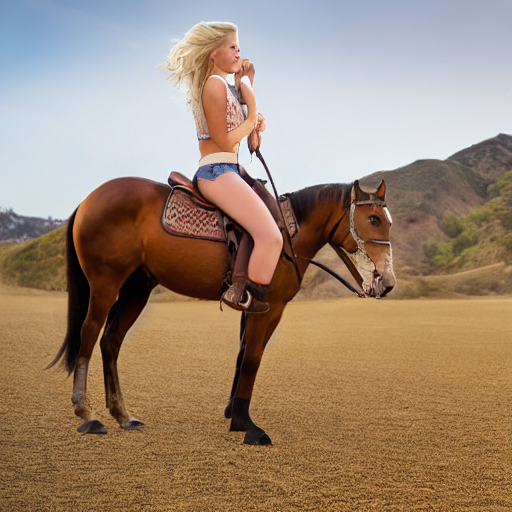

In [7]:
generator = torch.Generator(device="cuda").manual_seed(8)
print(type(generator))
image = pipeline(prompt, generator=generator).images[0]
print(type(image))
image

##### Changing the scheduler

Now show how easy it's to change the scheudler of a pipeline. Every scheduler has a property `compatibles` which defines all compatible schedulers.

In [11]:
print(type(pipeline.scheduler.compatibles))
pipeline.scheduler.compatibles

<class 'list'>


[diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_edm_euler.EDMEulerScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_discrete.KDPM2DiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,
 diffusers.utils.dummy_torch_and_torchsde_objects.DP

###### Comparing input prompts

We'll now compare input prompt with all other schedulers. To change scheduler of pipeline you can make use of convenient `config` property in combination with `from_config()` function.


In [8]:
pipeline.scheduler.config

FrozenDict([('num_train_timesteps', 1000),
            ('beta_start', 0.00085),
            ('beta_end', 0.012),
            ('beta_schedule', 'scaled_linear'),
            ('trained_betas', None),
            ('skip_prk_steps', True),
            ('set_alpha_to_one', False),
            ('prediction_type', 'epsilon'),
            ('timestep_spacing', 'leading'),
            ('steps_offset', 1),
            ('_use_default_values', ['prediction_type', 'timestep_spacing']),
            ('_class_name', 'PNDMScheduler'),
            ('_diffusers_version', '0.28.0.dev0'),
            ('clip_sample', False)])

Here, we change the schduler to DDIMSchduler.

In [9]:
from diffusers import DDIMScheduler
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)
print(pipeline.scheduler.config)

FrozenDict([('num_train_timesteps', 1000), ('beta_start', 0.00085), ('beta_end', 0.012), ('beta_schedule', 'scaled_linear'), ('trained_betas', None), ('clip_sample', False), ('set_alpha_to_one', False), ('steps_offset', 1), ('prediction_type', 'epsilon'), ('thresholding', False), ('dynamic_thresholding_ratio', 0.995), ('clip_sample_range', 1.0), ('sample_max_value', 1.0), ('timestep_spacing', 'leading'), ('rescale_betas_zero_snr', False), ('_use_default_values', ['prediction_type', 'clip_sample_range', 'timestep_spacing', 'thresholding', 'rescale_betas_zero_snr', 'sample_max_value', 'dynamic_thresholding_ratio']), ('skip_prk_steps', True), ('_class_name', 'DDIMScheduler'), ('_diffusers_version', '0.28.0.dev0')])


  0%|          | 0/50 [00:00<?, ?it/s]

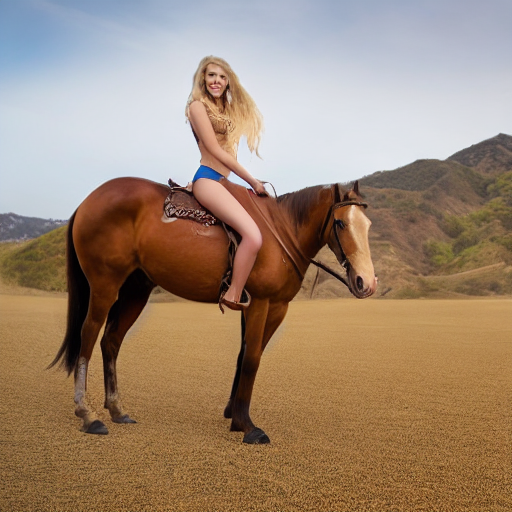

In [10]:
generator = torch.Generator(device="cuda").manual_seed(8)
image = pipeline(prompt, generator=generator).images[0]
image

##### Compare schedulers

[LMSDiscreteScheduler](https://huggingface.co/docs/diffusers/v0.27.2/en/api/schedulers/lms_discrete#diffusers.LMSDiscreteScheduler) usually leads to better results

FrozenDict([('num_train_timesteps', 1000), ('beta_start', 0.00085), ('beta_end', 0.012), ('beta_schedule', 'scaled_linear'), ('trained_betas', None), ('use_karras_sigmas', False), ('prediction_type', 'epsilon'), ('timestep_spacing', 'linspace'), ('steps_offset', 1), ('_use_default_values', ['prediction_type', 'timestep_spacing', 'use_karras_sigmas']), ('clip_sample', False), ('set_alpha_to_one', False), ('skip_prk_steps', True), ('_class_name', 'LMSDiscreteScheduler'), ('_diffusers_version', '0.28.0.dev0')])


  0%|          | 0/50 [00:00<?, ?it/s]

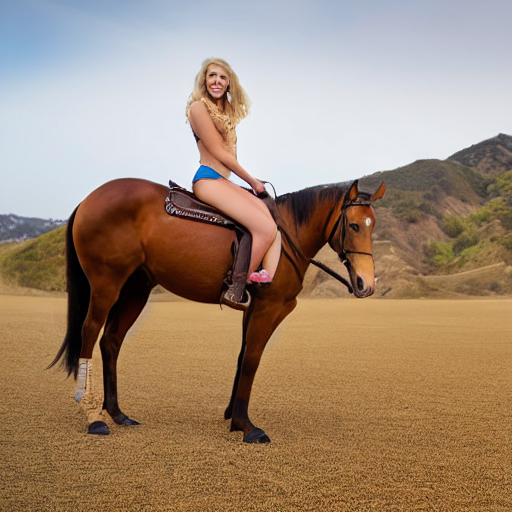

In [12]:
from diffusers import LMSDiscreteScheduler
pipeline.scheduler = LMSDiscreteScheduler.from_config(pipeline.scheduler.config)
print(pipeline.scheduler.config)
generator = torch.Generator(device="cuda").manual_seed(8)
image = pipeline(prompt, generator=generator).images[0]
image

[EulerDiscreteScheduler](https://huggingface.co/docs/diffusers/v0.27.2/en/api/schedulers/euler#diffusers.EulerDiscreteScheduler) and [EulerAncestralDiscreteScheduler](https://huggingface.co/docs/diffusers/v0.27.2/en/api/schedulers/euler_ancestral#diffusers.EulerAncestralDiscreteScheduler) can generate high quality results with as little as 30 steps.

FrozenDict([('num_train_timesteps', 1000), ('beta_start', 0.00085), ('beta_end', 0.012), ('beta_schedule', 'scaled_linear'), ('trained_betas', None), ('prediction_type', 'epsilon'), ('interpolation_type', 'linear'), ('use_karras_sigmas', False), ('sigma_min', None), ('sigma_max', None), ('timestep_spacing', 'linspace'), ('timestep_type', 'discrete'), ('steps_offset', 1), ('rescale_betas_zero_snr', False), ('_use_default_values', ['prediction_type', 'sigma_max', 'timestep_spacing', 'rescale_betas_zero_snr', 'use_karras_sigmas', 'interpolation_type', 'sigma_min', 'timestep_type']), ('clip_sample', False), ('set_alpha_to_one', False), ('skip_prk_steps', True), ('_class_name', 'EulerDiscreteScheduler'), ('_diffusers_version', '0.28.0.dev0')])


  0%|          | 0/30 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image was going to be returned. Try again with a different prompt and/or seed.


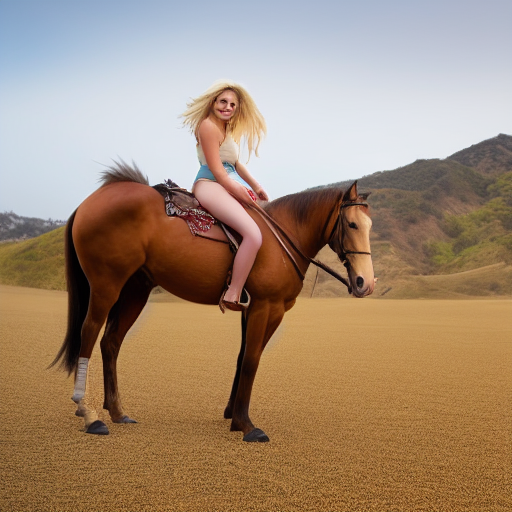

In [13]:
from diffusers import EulerDiscreteScheduler

pipeline.scheduler = EulerDiscreteScheduler.from_config(pipeline.scheduler.config)
print(pipeline.scheduler.config)
generator = torch.Generator(device="cuda").manual_seed(8)
image = pipeline(prompt, generator=generator, num_inference_steps=30).images[0]
image

  0%|          | 0/70 [00:00<?, ?it/s]

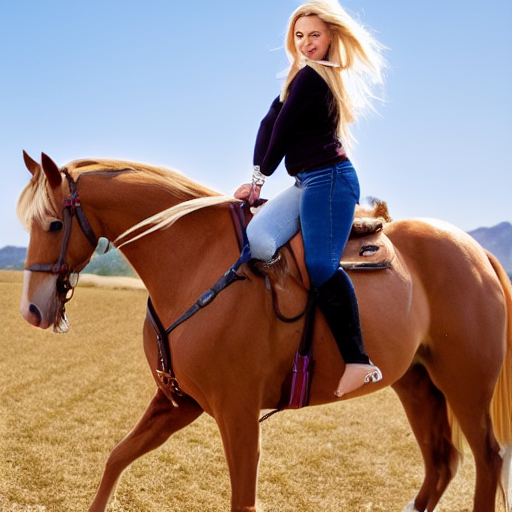

In [14]:
image = pipeline(prompt, generator=generator, num_inference_steps=70).images[0]
image

FrozenDict([('num_train_timesteps', 1000), ('beta_start', 0.00085), ('beta_end', 0.012), ('beta_schedule', 'scaled_linear'), ('trained_betas', None), ('prediction_type', 'epsilon'), ('timestep_spacing', 'linspace'), ('steps_offset', 1), ('rescale_betas_zero_snr', False), ('_use_default_values', ['prediction_type', 'timestep_spacing', 'rescale_betas_zero_snr']), ('clip_sample', False), ('set_alpha_to_one', False), ('skip_prk_steps', True), ('_class_name', 'EulerAncestralDiscreteScheduler'), ('_diffusers_version', '0.28.0.dev0')])


  0%|          | 0/30 [00:00<?, ?it/s]

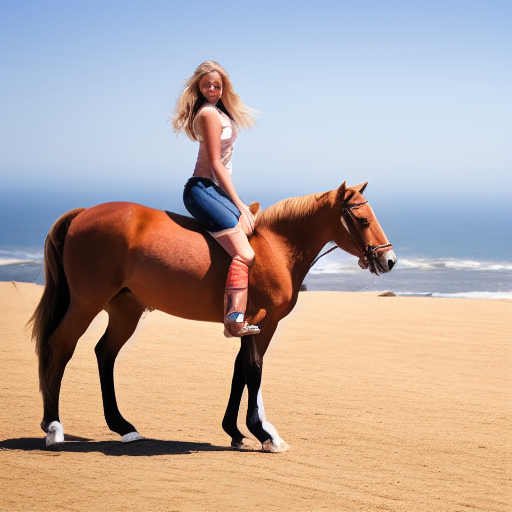

In [15]:
from diffusers import EulerAncestralDiscreteScheduler

pipeline.scheduler = EulerAncestralDiscreteScheduler.from_config(pipeline.scheduler.config)
print(pipeline.scheduler.config)
generator = torch.Generator(device="cuda").manual_seed(8)
image = pipeline(prompt, generator=generator, num_inference_steps=30).images[0]
image

[DPMSolverMultistepScheduler](https://huggingface.co/docs/diffusers/v0.27.2/en/api/schedulers/multistep_dpm_solver#diffusers.DPMSolverMultistepScheduler) gives a reasonable speed/quality trade-off and can be run with as little as 20 steps.

FrozenDict([('num_train_timesteps', 1000), ('beta_start', 0.00085), ('beta_end', 0.012), ('beta_schedule', 'scaled_linear'), ('trained_betas', None), ('solver_order', 2), ('prediction_type', 'epsilon'), ('thresholding', False), ('dynamic_thresholding_ratio', 0.995), ('sample_max_value', 1.0), ('algorithm_type', 'dpmsolver++'), ('solver_type', 'midpoint'), ('lower_order_final', True), ('euler_at_final', False), ('use_karras_sigmas', False), ('use_lu_lambdas', False), ('final_sigmas_type', 'zero'), ('lambda_min_clipped', -inf), ('variance_type', None), ('timestep_spacing', 'linspace'), ('steps_offset', 1), ('rescale_betas_zero_snr', False), ('_use_default_values', ['final_sigmas_type', 'prediction_type', 'euler_at_final', 'lower_order_final', 'use_lu_lambdas', 'timestep_spacing', 'rescale_betas_zero_snr', 'thresholding', 'use_karras_sigmas', 'algorithm_type', 'solver_order', 'solver_type', 'variance_type', 'sample_max_value', 'lambda_min_clipped', 'dynamic_thresholding_ratio']), ('clip_s

  0%|          | 0/20 [00:00<?, ?it/s]

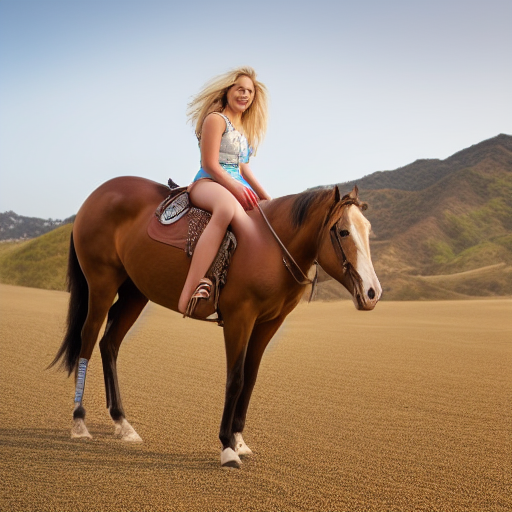

In [16]:
from diffusers import DPMSolverMultistepScheduler

pipeline.scheduler = DPMSolverMultistepScheduler.from_config(pipeline.scheduler.config)
print(pipeline.scheduler.config)
generator = torch.Generator(device="cuda").manual_seed(8)
image = pipeline(prompt, generator=generator, num_inference_steps=20).images[0]
image

##### Changing the Scheduler in Flax

If you're a JAX/Flax user, you can also change default pipeline scheduler. This is a complete example of how to run inference using the Flax Stable Diffusion pipeline and super-fast [DPM-Solver++ scheduler](https://huggingface.co/docs/diffusers/en/api/schedulers/multistep_dpm_solver):

In [3]:
import jax
import numpy as np
from flax.jax_utils import replicate
from flax.training.common_utils import shard

from diffusers import FlaxStableDiffusionPipeline, FlaxDPMSolverMultistepScheduler

In [4]:
example_model_subdir = data_sub_dirs.ModelsDiffusion / "runwayml" / "stable-diffusion-v1-5"
scheduler,scheduler_state = FlaxDPMSolverMultistepScheduler.from_pretrained(
    example_model_subdir,
    subfolder="scheduler")
print(type(scheduler))
print(type(scheduler_state))

2024-05-19 19:07:46.638260: W external/xla/xla/service/gpu/nvptx_compiler.cc:760] The NVIDIA driver's CUDA version is 12.3 which is older than the ptxas CUDA version (12.4.131). Because the driver is older than the ptxas version, XLA is disabling parallel compilation, which may slow down compilation. You should update your NVIDIA driver or use the NVIDIA-provided CUDA forward compatibility packages.


<class 'diffusers.schedulers.scheduling_dpmsolver_multistep_flax.FlaxDPMSolverMultistepScheduler'>
<class 'diffusers.schedulers.scheduling_dpmsolver_multistep_flax.DPMSolverMultistepSchedulerState'>


In [6]:
pipeline ,params = FlaxStableDiffusionPipeline.from_pretrained(
    example_model_subdir,
    scheduler=scheduler,
    revision="bf16",
    dtype=jax.numpy.bfloat16,)
print(type(pipeline))
print(type(params))
print(params)
#params["scheduler"] = scheduler_state

ValueError: `params` cannot be accessed from model when the model is created with `_do_init=False`. You must call `init_weights` manually and store the params outside of the model and pass it explicitly where needed.

In [9]:
pipeline = FlaxStableDiffusionPipeline.from_pretrained(
    example_model_subdir,
    scheduler=scheduler,
    revision="bf16",
    dtype=jax.numpy.bfloat16,)


ValueError: `params` cannot be accessed from model when the model is created with `_do_init=False`. You must call `init_weights` manually and store the params outside of the model and pass it explicitly where needed.

# Specific Pipeline Examples

## ControlNet

ControlNet is a type of model for controlling image diffusion models by conditioning model with an additional input image. There are many types of conditioning inputs (canny edge, user sketching, human pose, depth, and more) you can use to control a diffusion model.

Check out Section 3.5 of [ControlNet](https://huggingface.co/papers/2302.05543) paper v1 for list of ControlNet implementations on various conditioning inputs.

A ControlNet model has 2 sets of weights (or blocks) connected by a zero-convolution layer:
* a **locked copy** keeps everything a large pretrained diffusion model has learned
* a **trainable copy** is trained on the additional conditioning input

Since locked copy preserves the pretrained model, training and implementing a ControlNet on a new conditioning input is as fast as finetuning any other model because you aren't training the model from scratch.

### Text-to-image

For text-to-image, you normally pass a text prompt to the model.

But with ControlNet, specify an additional conditioning input. Condition the model with a "canny image", a white outline of an image on a black background.

Load an image and use opencv-python library to extract the canny image.

In [7]:
from diffusers.utils import load_image, make_image_grid
from PIL import Image
import cv2
import numpy as np

image_path = data_sub_dirs.Public / "Images" / "Playboy" / "TeddiSmith" / "tumblr_oythbaI80E1wykvxvo5_1280.jpg"
print(image_path.exists())

original_image = load_image(str(image_path))

image = np.array(original_image)

low_threshold = 100
high_threshold = 200

image = cv2.Canny(image, low_threshold, high_threshold)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
canny_image = Image.fromarray(image)

True


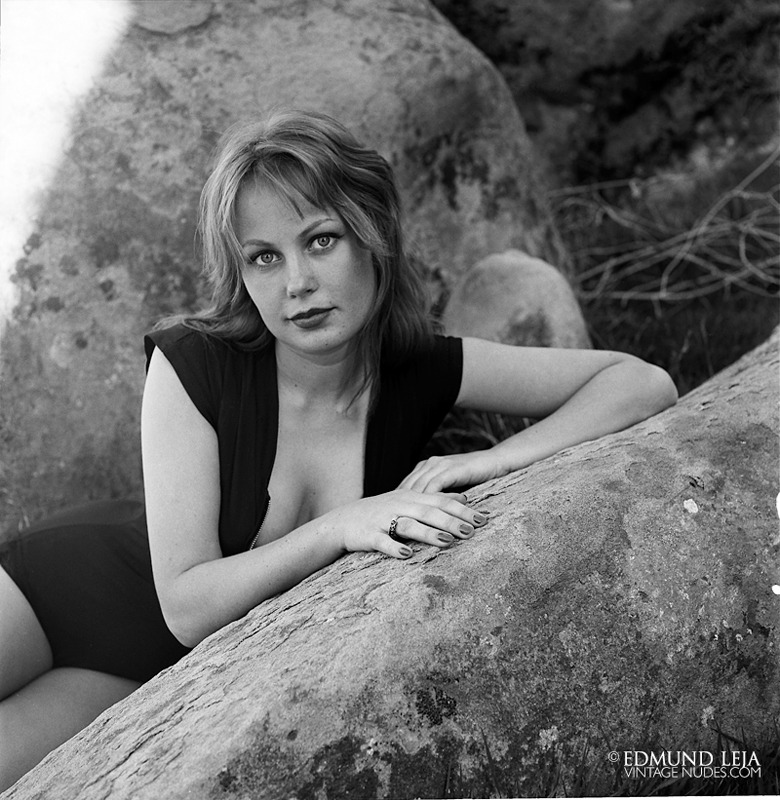

None


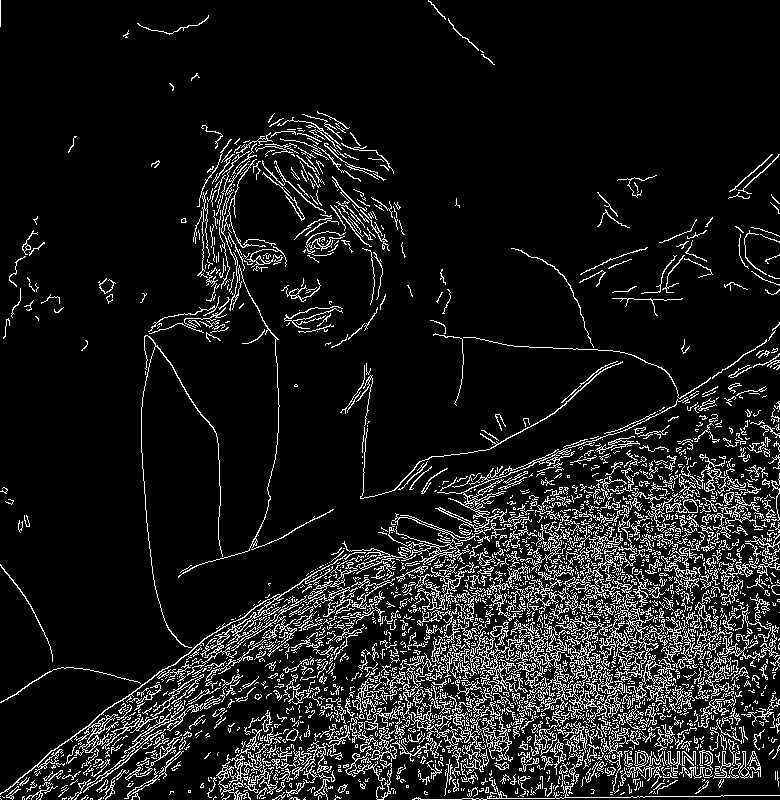

None


In [10]:
print(original_image.show())
print(canny_image.show())

Next, load a Controlnet model conditioned on canny edge dtection and pass it to [StableDiffusionControlNetPipeline](https://huggingface.co/docs/diffusers/v0.27.2/en/api/pipelines/controlnet#diffusers.StableDiffusionControlNetPipeline). Use the faster [UniPCMultistepScheduler](https://huggingface.co/docs/diffusers/v0.27.2/en/api/schedulers/unipc#diffusers.UniPCMultistepScheduler) and enable model offloading to speed up inference and reduce memory usage.

In [12]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, UniPCMultistepScheduler
import torch

controlnet_path = data_sub_dirs.ModelsDiffusion / "lllyasviel" / "sd-controlnet-canny"

controlnet = ControlNetModel.from_pretrained(
    controlnet_path,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)
print(type(controlnet))

/usr/local/lib/python3.10/dist-packages/numpy/core/getlimits.py:549: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/usr/local/lib/python3.10/dist-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float64'> type is zero.
  return self._float_to_str(self.smallest_subnormal)
/usr/local/lib/python3.10/dist-packages/numpy/core/getlimits.py:549: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  setattr(self, word, getattr(machar, word).flat[0])
/usr/local/lib/python3.10/dist-packages/numpy/core/getlimits.py:89: UserWarning: The value of the smallest subnormal for <class 'numpy.float32'> type is zero.
  return self._float_to_str(self.smallest_subnormal)


In [13]:
model_path = data_sub_dirs.ModelsDiffusion / "runwayml" / "stable-diffusion-v1-5"
pipe = StableDiffusionControlNetPipeline.from_pretrained(
    model_path,
    controlnet=controlnet,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)
pipe.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  vae
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'variant': None, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  scheduler
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  unet
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'variant': None, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  feature_extractor
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  text_encoder
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
na

Now pass your prompt and canny image to the pipeline:

In [14]:
prompt = "Gorgeous, pretty all-American blue eye girl, California blonde bombshell, pursed pink lips, \
    posing, wearing white two-piece bikini, slim, toned, elegant \
    body, in a Beverly Hills hotel patio, photo realistic hyperdetail, symmetrical balance, in-frame \
    close portrait, 8K 4K, hi-res, realistic skin texture"

  0%|          | 0/50 [00:00<?, ?it/s]

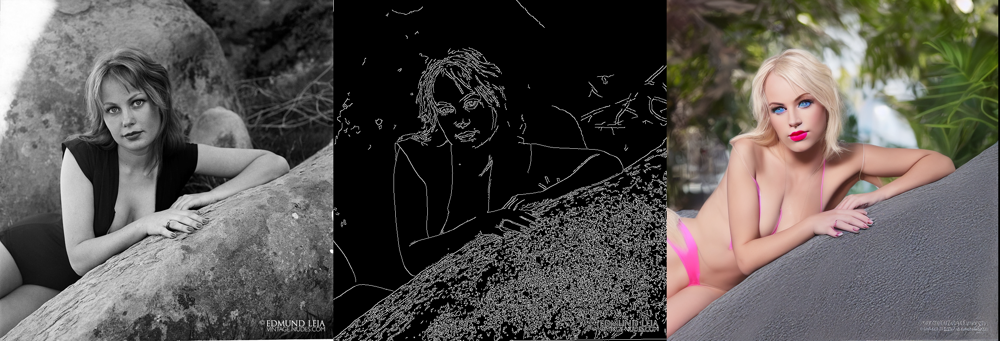

In [ ]:
output = pipe(prompt, image=canny_image).images[0]
make_image_grid([original_image, canny_image, output], rows=1, cols=3)

### Image-to-image

For image-to-image, you'd typically pass an initial image and prompt to pipeline to generate a new image. With ControlNet, you can pass an additional conditioning input to guide the model.

Let's condition the model with a depth map, an image which contains spatial information.

You'll use the [StableDiffusionControlNetImg2ImgPipeline](https://huggingface.co/docs/diffusers/v0.27.2/en/api/pipelines/controlnet#diffusers.StableDiffusionControlNetImg2ImgPipeline) for this task, which is different from the [StableDiffusionControlNetPipeline](https://huggingface.co/docs/diffusers/v0.27.2/en/api/pipelines/controlnet#diffusers.StableDiffusionControlNetPipeline) because it allows you to pass an initial image as starting point for image generation process.

Load an image and use the depth-estimation Pipeline from huggingface Transformers to extract the depth map of an image.

In [20]:
import torch
import numpy as np

from transformers import pipeline
from diffusers.utils import load_image, make_image_grid

image_file_path = data_sub_dirs.Public / "Images" / "Playboy" / "TeddiSmith" / "U6S88ytE0BQ.jpg"
print(image_file_path.exists())

image = load_image(str(image_file_path))

True


In [21]:
def get_depth_map(image, depth_estimator):
    image = depth_estimator(image)["depth"]
    image = np.array(image)
    image = image[:, :, None]
    image = np.concatenate([image, image, image], axis=2)
    detected_map = torch.from_numpy(image).float() / 255.0
    depth_map = detected_map.permute(2, 0, 1)
    return depth_map

In [22]:
depth_estimator = pipeline("depth-estimation")
print(type(depth_estimator))
depth_map = get_depth_map(image, depth_estimator).unsqueeze(0).half().to("cuda")
print(type(depth_map))

No model was supplied, defaulted to Intel/dpt-large and revision e93beec (https://huggingface.co/Intel/dpt-large).
Using a pipeline without specifying a model name and revision in production is not recommended.


config.json:   0%|          | 0.00/942 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.37G [00:00<?, ?B/s]

Some weights of DPTForDepthEstimation were not initialized from the model checkpoint at Intel/dpt-large and are newly initialized: ['neck.fusion_stage.layers.0.residual_layer1.convolution2.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution2.bias', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.weight', 'neck.fusion_stage.layers.0.residual_layer1.convolution1.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


preprocessor_config.json:   0%|          | 0.00/285 [00:00<?, ?B/s]

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.


<class 'transformers.pipelines.depth_estimation.DepthEstimationPipeline'>
<class 'torch.Tensor'>


Next, load a ControlNet model conditioned on depth maps and pass it to the [StableDiffusionControlNetImg2ImgPipeline](https://huggingface.co/docs/diffusers/v0.27.2/en/api/pipelines/controlnet#diffusers.StableDiffusionControlNetImg2ImgPipeline). Use the faster [UniPCMultistepScheduler](https://huggingface.co/docs/diffusers/v0.27.2/en/api/schedulers/unipc#diffusers.UniPCMultistepScheduler).

In [24]:
from diffusers import StableDiffusionControlNetImg2ImgPipeline, ControlNetModel, UniPCMultistepScheduler
import torch

controlnet_path = controlnet_path = data_sub_dirs.ModelsDiffusion / "lllyasviel" / "control_v11f1p_sd15_depth"

controlnet = ControlNetModel.from_pretrained(
    controlnet_path,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)

model_path = data_sub_dirs.ModelsDiffusion / "runwayml" / "stable-diffusion-v1-5"

pipe = StableDiffusionControlNetImg2ImgPipeline.from_pretrained(
    model_path,
    controlnet=controlnet,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)
pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)
pipe.enable_model_cpu_offload()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  vae
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'variant': None, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  scheduler
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  unet
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'variant': None, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  feature_extractor
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  text_encoder
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
na

In [25]:
prompt = "Gorgeous, pretty all-American blue eye girl, California blonde bombshell, pursed pink lips, \
    posing, wearing white two-piece bikini, slim, toned, elegant \
    body, in a Beverly Hills hotel patio, photo realistic hyperdetail, symmetrical balance, in-frame \
    close portrait, 8K 4K, hi-res, realistic skin texture"

In [27]:
output = pipe(prompt, image=image, control_image=depth_map,).images[0]
make_image_grid([image, output], rows=1, cols=2)

  0%|          | 0/40 [00:00<?, ?it/s]

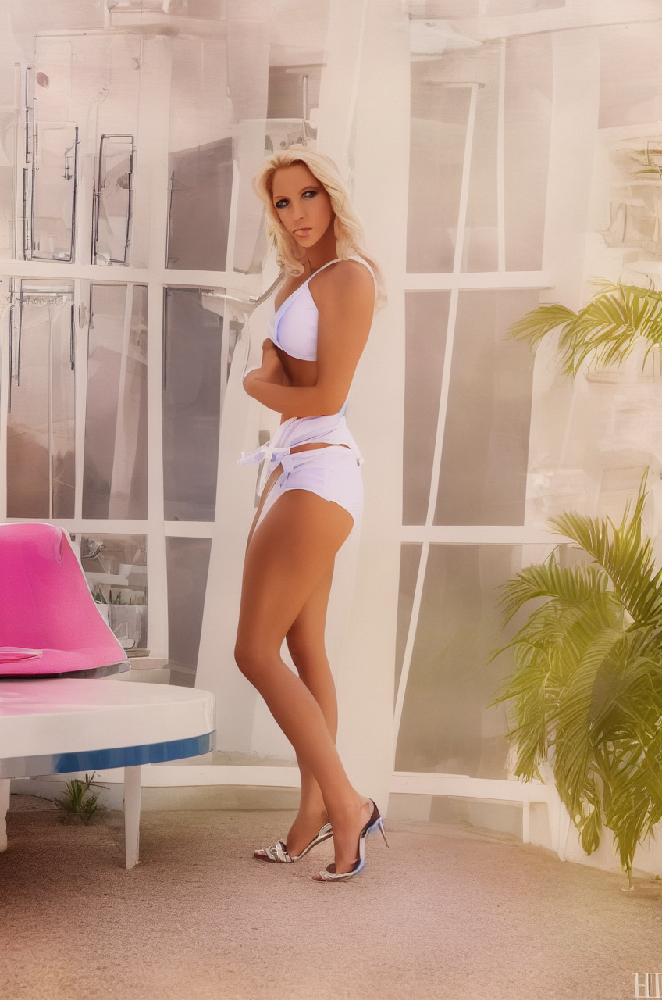

In [28]:
output

### Inpainting

For inpainting, you need an initial image, a mask image, and a prompt to describe what to replace th mask with.
ControlNet models allow you to add another control image to condition a model with. Let's condition the model with an inpainting mask. This way, ControlNet can use the inpainting mask as a control to guide the model to generate an image within the mask area.

Load an initial image and a mask image:

In [2]:
from diffusers.utils import load_image, make_image_grid

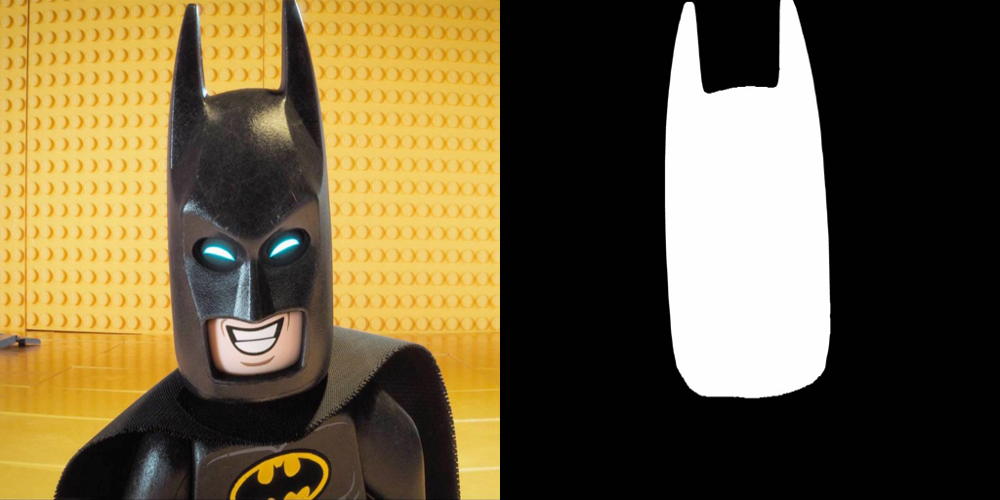

In [3]:
init_image = load_image(
        "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/controlnet-inpaint.jpg"
)

init_image = init_image.resize((512, 512))

mask_image = load_image(
    "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/controlnet-inpaint-mask.jpg"
)

mask_image = mask_image.resize((512, 512))
make_image_grid([init_image, mask_image], rows=1, cols=2)

Create a function to prepare the control image from the initial and mask images. This'll create a tensor to mark the pixels in init_image as masked if corresponding pixel in mask_image is over a certain threshold.

In [4]:
import numpy as np
import torch

def make_inpaint_condition(image, image_mask):
    image = np.array(image.convert("RGB")).astype(np.float32) / 255.0
    image_mask = np.array(image_mask.convert("L")).astype(np.float32) / 255.0
    
    assert image.shape[0:1] == image_mask.shape[0:1]
    image[image_mask > 0.5] = -1.0 # set as masked pixel
    image = np.expand_dims(image, 0).transpose(0, 3, 1, 2)
    image = torch.from_numpy(image)
    return image

In [7]:
control_image = make_inpaint_condition(init_image, mask_image)
print(type(control_image))
print(control_image.size())

<class 'torch.Tensor'>
torch.Size([1, 3, 512, 512])


Load a ControlNet model conditioned on inpainting and pass it to the StableDiffusionControlNetInpaintPipeline. Use faster UniPCMultistepScheduler and enable model offloading to speed up inference and reduce memory usage.

In [13]:
from diffusers import StableDiffusionControlNetInpaintPipeline, ControlNetModel, UniPCMultistepScheduler

controlnet_path = controlnet_path = data_sub_dirs.ModelsDiffusion / "lllyasviel" / "control_v11p_sd15_inpaint"
print(controlnet_path.exists())

controlnet = ControlNetModel.from_pretrained(
    controlnet_path,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)

model_path = data_sub_dirs.ModelsDiffusion / "runwayml" / "stable-diffusion-v1-5"

pipe = StableDiffusionControlNetInpaintPipeline.from_pretrained(
    model_path,
    controlnet=controlnet,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)

print("Before: \n", pipe.scheduler.config)

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

print("After: \n", pipe.scheduler.config)

pipe.enable_model_cpu_offload()

True


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  vae
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'variant': None, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  tokenizer
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  scheduler
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  safety_checker
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  unet
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'variant': None, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  t

In [14]:
prompt = "A fashion editorial of an extremely beautiful model wearing a pink lace and frill dress, \
    standing in a garden full of flowers and smoke, with a dreamy atmosphere and volumetric light, \
    in the style of Tim Walker. --ar 41:64 --v 6.0"

  0%|          | 0/20 [00:00<?, ?it/s]

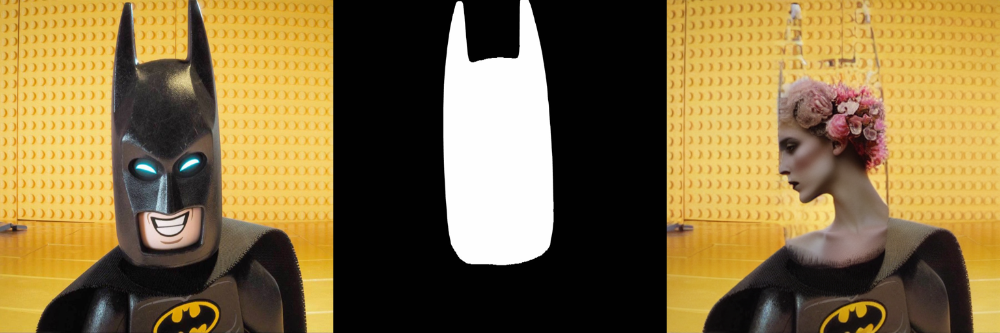

In [15]:
output = pipe(
    prompt,
    num_inference_steps=20,
    eta=1.0,
    image=init_image,
    mask_image=mask_image,
    control_image=control_image,).images[0]
make_image_grid([init_image, mask_image, output], rows=1, cols=3)

### Guess mode

Guess mode doesn't require supplying a prompt to ControlNet at all! This forces ControlNet encoder to do its best to "guess" the contents of the input control map (depth map, pose estimation, canny edge, etc.).

Guess mode adjusts scale of the output residuals from a ControlNet by a fixed ratio depending on the block depth.
The shallowest DownBlock corresponds to 0.1 and as the blocks get deeper, the scale increases exponentially such that the scale of MidBlock output becomes 1.0.

Guess mode doesn't have any impact on prompt conditioing and you can still provide a prompt if you want.

Set guess_mode=True in the pipeline, and it's [recommended](https://github.com/lllyasviel/ControlNet#guess-mode--non-prompt-mode) to set the guidance_scale value between 3.0 and 5.0.

True


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  scheduler
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  text_encoder
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  safety_checker
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  unet
{'torch_dtype': torch.float16, 'device_map': None, 'max_memory': None, 'offload_folder': None, 'offload_state_dict': False, 'variant': None, 'low_cpu_mem_usage': True}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  tokenizer
{}
cached_folder:  /Data/Models/Diffusion/runwayml/stable-diffusion-v1-5
name:  feature_e

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image was going to be returned. Try again with a different prompt and/or seed.


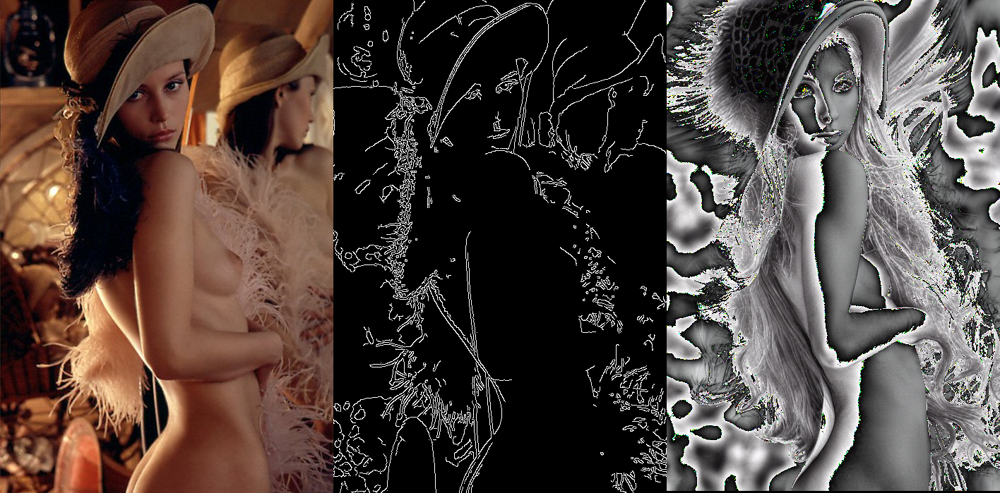

In [4]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel
from diffusers.utils import load_image, make_image_grid
import numpy as np
import torch
from PIL import Image
import cv2

controlnet_path = controlnet_path = data_sub_dirs.ModelsDiffusion / "lllyasviel" / "sd-controlnet-canny"
print(controlnet_path.exists())

controlnet = ControlNetModel.from_pretrained(
    controlnet_path,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)

model_path = data_sub_dirs.ModelsDiffusion / "runwayml" / "stable-diffusion-v1-5"

pipe = StableDiffusionControlNetPipeline.from_pretrained(
    model_path,
    controlnet=controlnet,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)
print(type(pipe))
pipe = pipe.to("cuda")
print(type(pipe))

image_file_path = data_sub_dirs.Public / "Images" / "Playboy" / "LennaSjööblom_LenaForsén" / "qShFGgyfM2o8OTptV6bGyf_9QVDc7x2ua38DJyWci9nsRi8u2ZJunn27MMP8vji6wZmUna5cR7TDxpC_p1wrzVinINlkVsl8tB6JY3RF81L9bAU38H4N-EQwDtEWWUT2.jpeg"
print(image_file_path.exists())

original_image = load_image(str(image_file_path))
image = np.array(original_image)
low_threshold = 100
high_threshold = 200
image = cv2.Canny(image, low_threshold, high_threshold)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
canny_image = Image.fromarray(image)

image = pipe("", image=canny_image, guess_mode=True, guidance_scale=3.0).images[0]
make_image_grid([original_image, canny_image, image], rows=1, cols=3)

### ControlNet with Stable Diffusion XL

Let's use a SDXL ControlNet conditioned on canny images to generate an image.

True


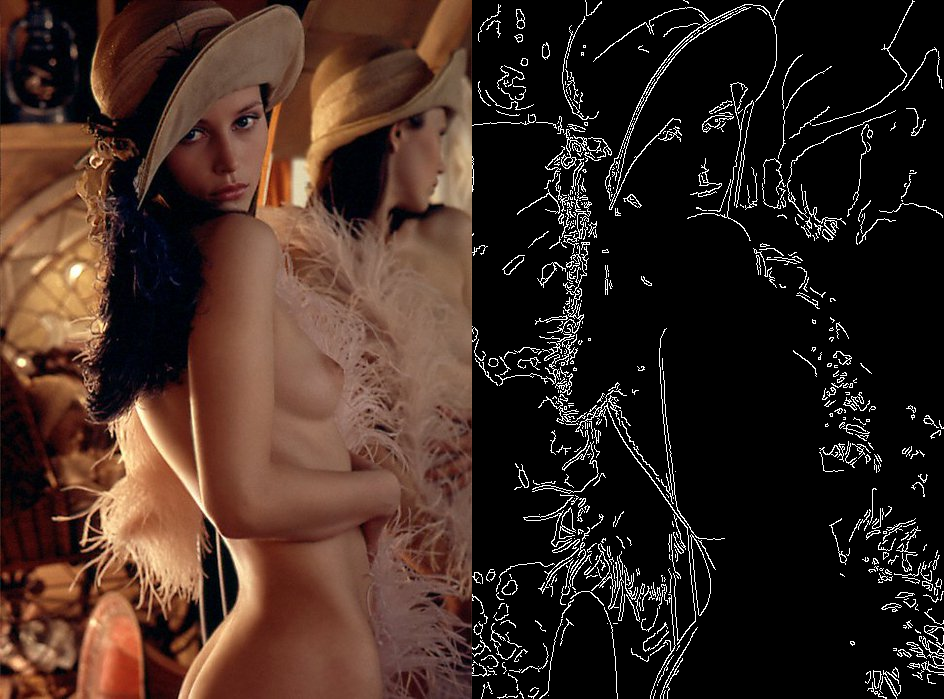

In [5]:
from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel, AutoencoderKL
from diffusers.utils import load_image, make_image_grid
from PIL import Image
import cv2
import numpy as np
import torch

image_file_path = data_sub_dirs.Public / "Images" / "Playboy" / "LennaSjööblom_LenaForsén" / "qShFGgyfM2o8OTptV6bGyf_9QVDc7x2ua38DJyWci9nsRi8u2ZJunn27MMP8vji6wZmUna5cR7TDxpC_p1wrzVinINlkVsl8tB6JY3RF81L9bAU38H4N-EQwDtEWWUT2.jpeg"
print(image_file_path.exists())

original_image = load_image(str(image_file_path))

image = np.array(original_image)

low_threshold = 100
high_threshold = 200

image = cv2.Canny(image, low_threshold, high_threshold)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
canny_image = Image.fromarray(image)
make_image_grid([original_image, canny_image], rows=1, cols=2)

Load a SDXLControlNet model conditioned on canny edge detection and pass it to the [StableDiffusionXLControlNetPipeline](https://huggingface.co/docs/diffusers/main/en/api/pipelines/controlnet_sdxl#diffusers.StableDiffusionXLControlNetPipeline).

In [ ]:
controlnet_path = controlnet_path = data_sub_dirs.ModelsDiffusion / "diffusers" / "controlnet-canny-sdxl-1.0"
print(controlnet_path.exists())

controlnet = ControlNetModel.from_pretrained(
    controlnet_path,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)

print(type(controlnet))

# https://huggingface.co/madebyollin/sdxl-vae-fp16-fix
# Using this VAE instead of the VAE that comes with SDXL because the Model card says that this modification allows
# to run in fp16 precision without generating NaNs. This is because the SDXL-VAE generates NaNs in fp16 because
# the internal activation values are too big.
vae_path = data_sub_dirs.ModelsDiffusion / "madebyollin" / "sdxl-vae-fp16-fix"
print(vae_path.exists())

vae = AutoencoderKL.from_pretrained(
    vae_path,
    torch_dtype=torch.float16,
    use_safetensors=True,
    local_files_only=True)

print(type(vae))